## Import the necessary packages

In [1]:
import sys
import cv2
import numpy as np
from pylab import rcParams
import matplotlib.pyplot as plt

rcParams['figure.figsize'] = 5, 5
%matplotlib inline

In [2]:
def plot(dataset):
    
    plt.figure(figsize=(60, 60))
    for i in range(len(dataset)):
        plt.subplot(1, 2, i+1)
        plt.imshow(dataset[i], cmap='gray')
        plt.xticks([])
        plt.yticks([])
    
plt.tight_layout()
plt.show()

<Figure size 432x288 with 0 Axes>

Get item

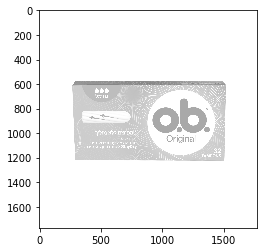

In [3]:
item = cv2.imread('dataset/items/6.jpg', cv2.IMREAD_GRAYSCALE) 
rgb_item = cv2.imread('dataset/items/6.jpg') 
results = []
plt.imshow(item, cmap='gray')

Get shelfs

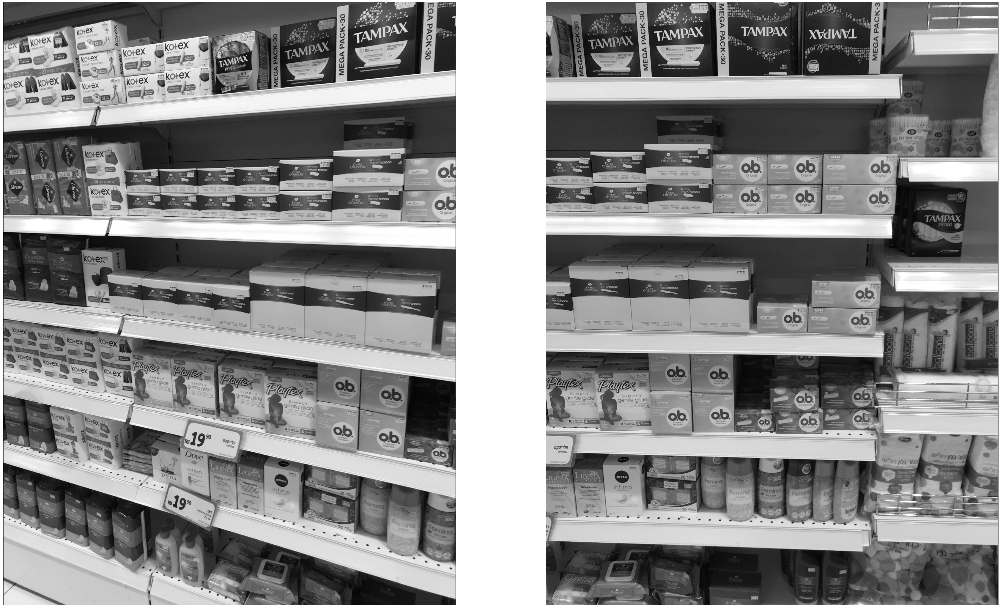

In [4]:
shelfs = [] 

shelfs.append(cv2.imread('dataset/shelfs/4.jpg', cv2.IMREAD_GRAYSCALE))
shelfs.append(cv2.imread('dataset/shelfs/7.jpg', cv2.IMREAD_GRAYSCALE))

rgb_shelf_1 = cv2.imread('dataset/shelfs/4.jpg')
rgb_shelf_2 = cv2.imread('dataset/shelfs/7.jpg')

plot(shelfs)

## Get Descriptors
Create SIFT

In [5]:
sift = cv2.xfeatures2d.SIFT_create()

In [6]:
#items_keypoint = []
keypoints, descriptors = sift.detectAndCompute(item, None)
item_sift = cv2.drawKeypoints(item, keypoints, None)
item_info = (item_sift, keypoints, descriptors)

Dispaly all the keypoint

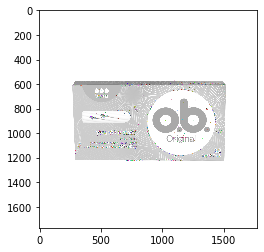

In [7]:
plt.imshow(item_info[0], cmap='gray')

 Get Descriptors for the shelfs in the same way.

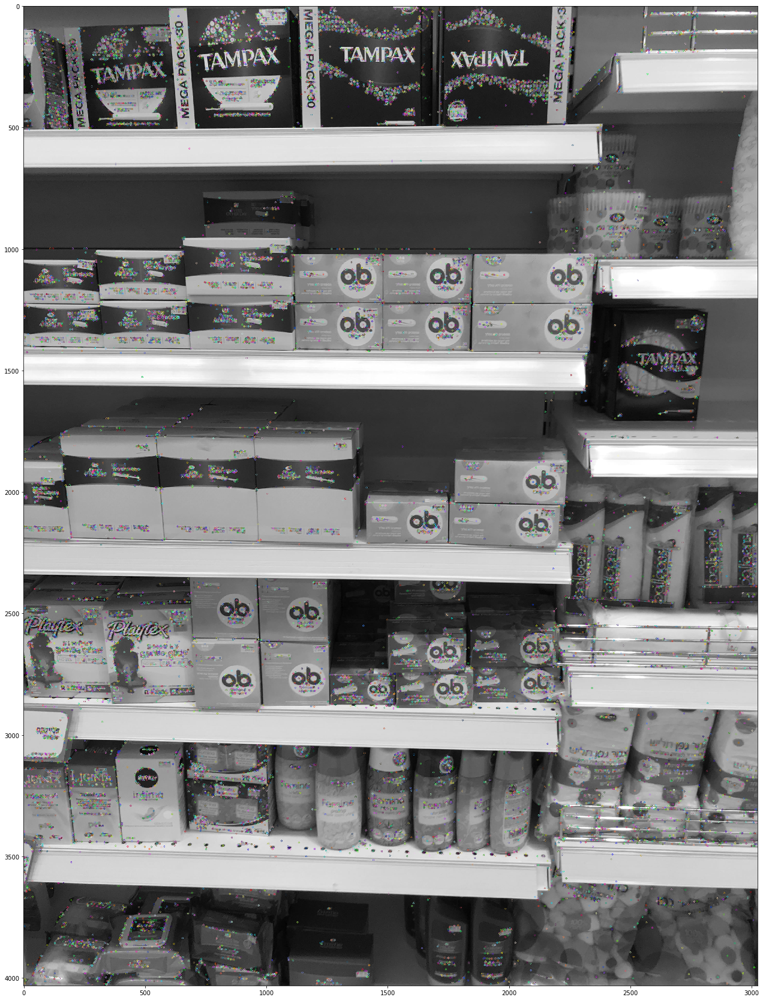

In [8]:
shelf_keypoints, shelf_descriptors = sift.detectAndCompute(shelfs[1], None)
shelf_sift = cv2.drawKeypoints(shelfs[1], shelf_keypoints, None)

rcParams['figure.figsize'] = 30, 30
plt.imshow(shelf_sift, cmap='gray')

## FLANN based Matcher
FLANN stands for Fast Library for Approximate Nearest Neighbors.

In [9]:
FLANN_INDEX_KDTREE = 1
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 50)
search_params = dict(checks=100)

flann = cv2.FlannBasedMatcher(index_params, search_params)

Let's look for O.B item in the above shelfs, remember that item_info hold (image with keypoints, keypoints, descriptors).

In [10]:
obj_img, obj_keypoint, obj_descriptors = item_info
matches = flann.knnMatch(obj_descriptors, shelf_descriptors, k=2)

Let's Match

In [11]:
matchesMask = [[0,0] for i in range(len(matches))]
for i,(m,n) in enumerate(matches):
    if m.distance < 0.7*n.distance:
        matchesMask[i]=[1,0]
        
draw_params = dict(matchColor = (0,255,0),
                   singlePointColor = (255,0,0),
                   matchesMask = matchesMask,
                   flags = cv2.DrawMatchesFlags_DEFAULT)

output = cv2.drawMatchesKnn(obj_img, obj_keypoint, shelf_sift, shelf_keypoints,matches,None,**draw_params)
results.append(output)

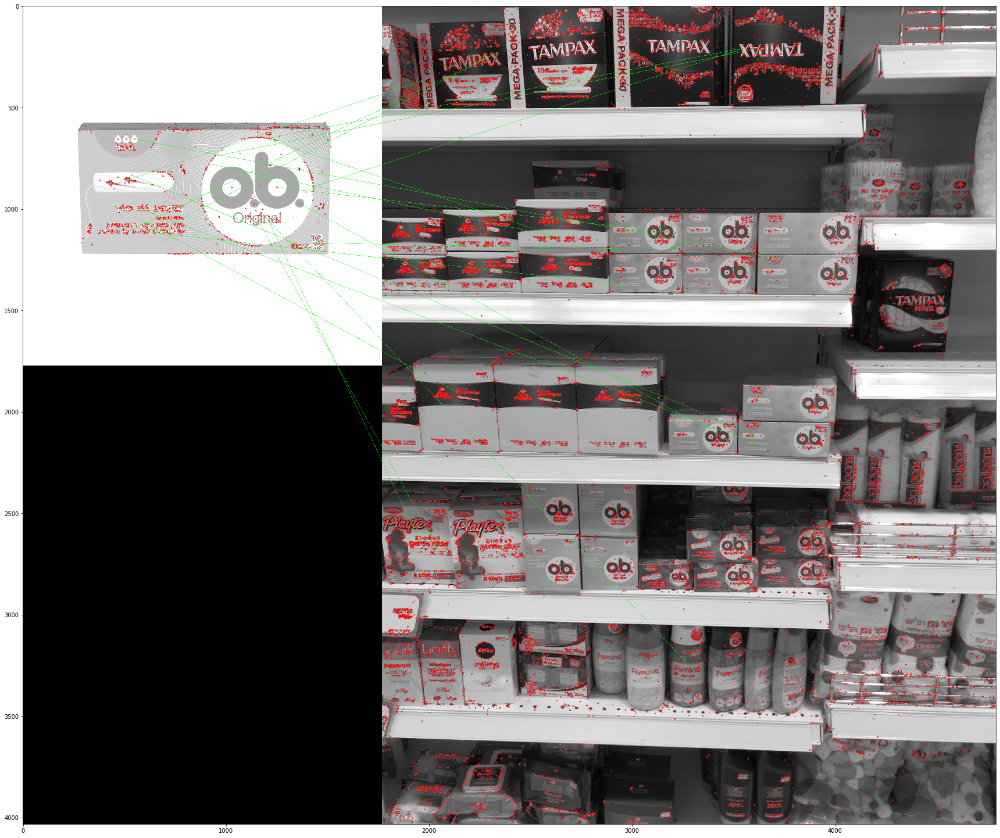

In [12]:
plt.imshow(output, cmap='gray')

## And now let's reduce the search space with Sliding Window.
After sliding window we will get bounding box, and then apply FLANN Matcher for each box.
Then define threshold number, and if the number of matches pass the threshold number i will sign that box as "successful box".

In [13]:
original_shelf = rgb_shelf_2.copy()
original_shelf = cv2.resize(original_shelf, (900, 900))

windows = []
windows_info = []

stepSize = 55
(width, height) = (50, 50) # window size
for x in range(0, original_shelf.shape[1] - width + 1 , stepSize):
    for y in range(0, original_shelf.shape[0] - height + 1 , stepSize ):
        window = original_shelf[x:x + width, y:y + height, :]
        windows.append(window)
        windows_info.append((x, y, width, height))
        cv2.rectangle(original_shelf, (x, y), (x + width, y + height), (0, 255, 0), 2)


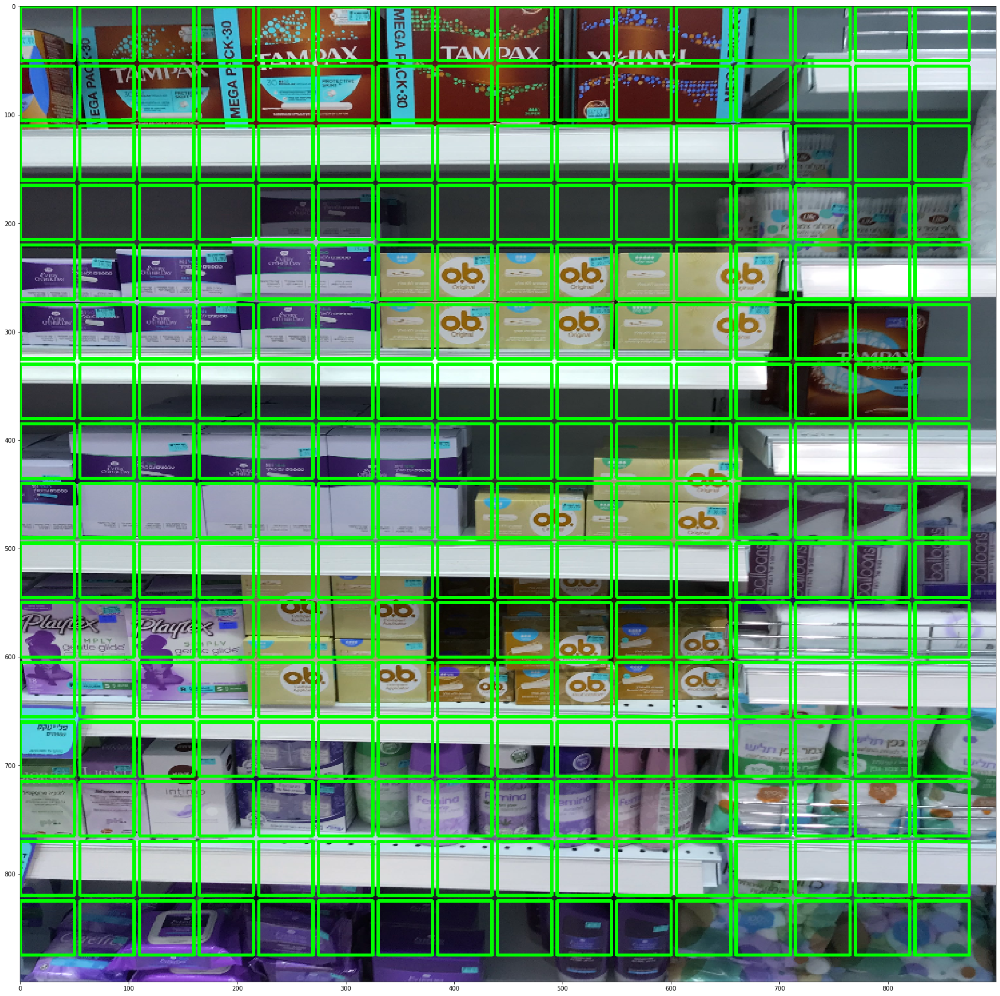

In [14]:
plt.imshow(np.array(original_shelf).astype('uint8'))
plt.show()

###### Note: I use "try except" because the windows might be not include interesting points.

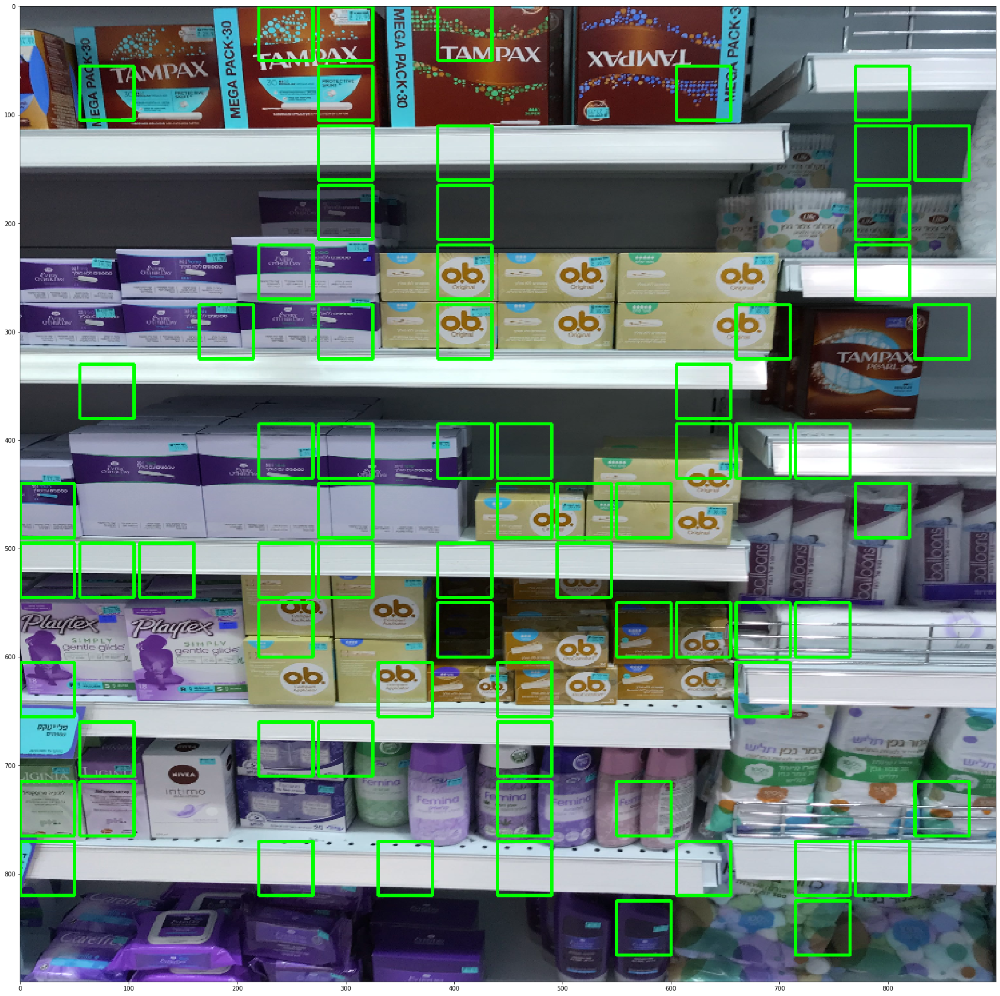

In [15]:
shelf_output = rgb_shelf_2.copy()
shelf_output = cv2.resize(shelf_output, (900, 900))

for i in range(len(windows)):
      
    patche_keypoints, patche_descriptors = sift.detectAndCompute(windows[i], None)
        
    try:
        matches = flann.knnMatch(obj_descriptors, patche_descriptors, k=2)
    except:
        continue
    
    matches_num = 0
    for j,(m,n) in enumerate(matches):
        if m.distance < 0.55*n.distance:
            matches_num = matches_num + 1
                           
        if matches_num >= 3:
            x, y, w, h  = windows_info[i]
            cv2.rectangle(shelf_output, (x, y), (x+w, y+h), (0, 255, 0), 2)
        
plt.imshow(shelf_output)
results.append(shelf_output)

 ## The same idea but now with  Selective Search.
After Selective Search we will get bounding boxs, and then apply FLANN Matcher for each box.
Then define threshold number, and if the number of matches pass the threshold number i will sign that box as "successful box".

###### NOTE: I have to reduce the image resolution because using CPU.

In [16]:
def selective_search(im):

    cv2.setUseOptimized(True)
    cv2.setNumThreads(8)
    
    patches_list = []
    patche_info = []

    im = cv2.resize(im, (900, 900))    
    # create Selective Search Segmentation Object using default parameters
    ss = cv2.ximgproc.segmentation.createSelectiveSearchSegmentation()

    ss.setBaseImage(im) 
    ss.switchToSelectiveSearchFast()
    
    rects = ss.process()
    print('Total Number of Region Proposals: {}'.format(len(rects)))
        
   
    imOut = im.copy()
    
    for i, rect in enumerate(rects):
        
        x, y, w, h = rect
        cv2.rectangle(imOut, (x, y), (x+w, y+h), (0, 255, 0), 1, cv2.LINE_AA)
        # crop and save bounding boxs and there coordinates
        patche_info.append((x, y, w, h))
        patches_list.append(im[y:y+h, x:x+w])
        
    return (imOut, patches_list, patche_info)

In [17]:
original_shelf = rgb_shelf_2.copy()
original_shelf = cv2.resize(original_shelf, (900, 900))

bounding_box, patches, patche_info = selective_search(original_shelf)

Total Number of Region Proposals: 8980


Let's take a look... 

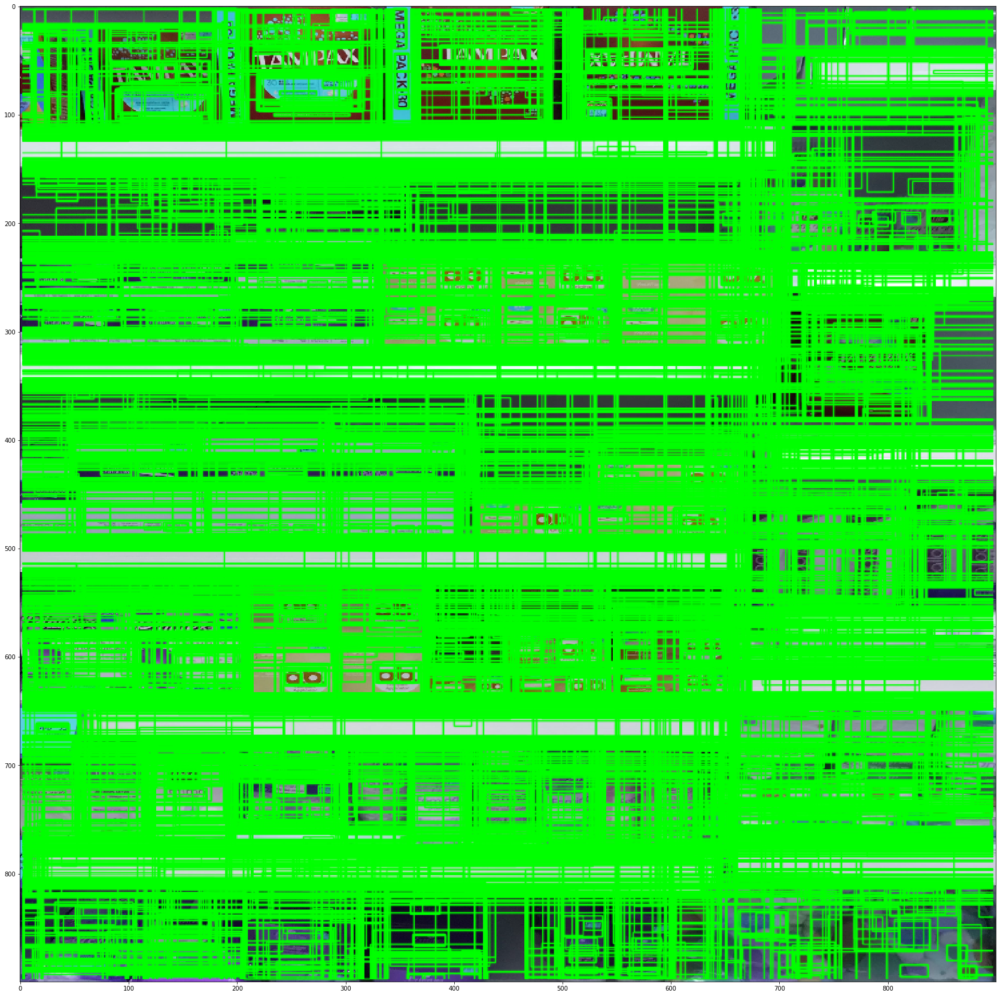

In [18]:
rcParams['figure.figsize'] = 30, 30
plt.imshow(bounding_box)

Save only the patches with "Normal" size.

In [19]:
objects_bounding_boxs = []
objects_bounding_boxs_info = [] 

for i in range(len(patches)):   
    if (patches[i].shape[0] > 70 and patches[i].shape[0] < 100) and (patches[i].shape[1] < 120 and patches[i].shape[1] > 100):
        objects_bounding_boxs.append(patches[i])
        objects_bounding_boxs_info.append(patche_info[i])
print('There is', len(objects_bounding_boxs), 'region proposals in "Normal" size.')

There is 88 region proposals in "Normal" size.


20 samples from 88 region proposals:

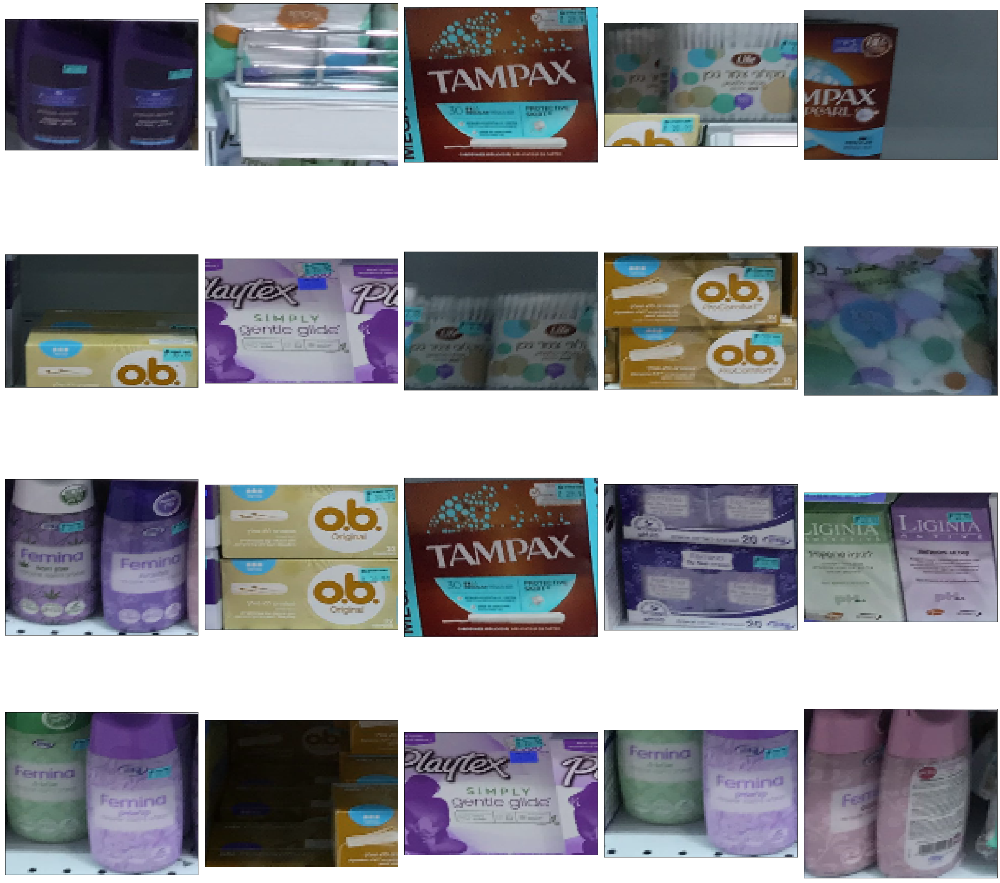

In [20]:
for i in range(20):    
    plt.subplot(4, 5, i+1)
    plt.imshow(objects_bounding_boxs[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()

Apply FLANN Matcher for each patche

In [21]:
shelf_output = rgb_shelf_2.copy()
shelf_output = cv2.resize(shelf_output, (900, 900))

bounding_boxes_after_sift = []
bounding_boxes_after_sift_info = []

for i in range(len(objects_bounding_boxs)):
      
    patche_keypoints, patche_descriptors = sift.detectAndCompute(objects_bounding_boxs[i], None)
    
    try:
        matches = flann.knnMatch(obj_descriptors, patche_descriptors, k=2)
    except:
        continue
        
    matches_num = 0
    for j,(m,n) in enumerate(matches):
        if m.distance < 0.6*n.distance:   
            matches_num = matches_num + 1            

            
    if matches_num >= 10:
        x, y, w, h  = objects_bounding_boxs_info[i]         
        cv2.rectangle(shelf_output, (x, y), (x+w, y+h), (0, 255, 0), 2)
        bounding_boxes_after_sift.append(shelf_output[y:y+h, x:x+w])
        bounding_boxes_after_sift_info.append((x, y, w, h))

The number of bounding boxes: 17


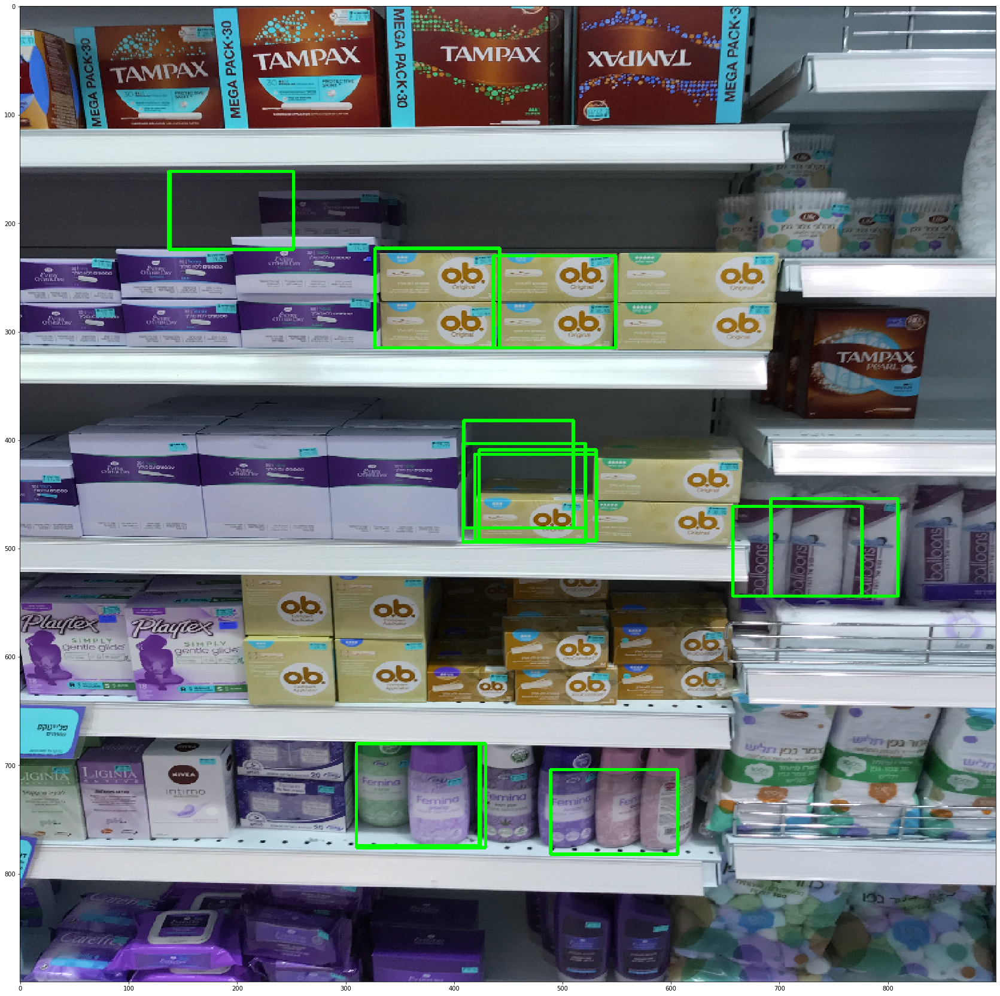

In [22]:
print('The number of bounding boxes:', len(bounding_boxes_after_sift))
plt.imshow(shelf_output)
results.append(shelf_output)

##  Reduce the search space for items.
The main idea is:  
        ● Select only the area where the text located.  
        ● Once we have detected the text regions , we’ll then extract each of the text ROIs and apply SIFT. 
        
        
###### Text detection using OpenCV’s EAST text detector, a highly accurate deep learning text detector used to detect text in natural scene images.

The EAST text requires that your input image dimensions be multiples of 32.

In [23]:
image = rgb_item.copy()
orig = image.copy()
(H, W) = image.shape[:2]

Set the new width and height and then determine the ratio in change for both the width and height.

In [24]:
(newW, newH) = (320, 320)
rW = W / float(newW)
rH = H / float(newH)

Resize the image and grab the new image dimensions

In [25]:
image = cv2.resize(image, (newW, newH))

(H, W) = image.shape[:2]

In order to perform text detection using OpenCV and the EAST deep learning model, we need to extract the output feature maps of two layers.  
● The first layer: is our output sigmoid activation which gives us the probability of a region containing text or not.  
● The second layer: is the output feature map that represents the “geometry” of the image — we’ll be able to use this geometry to derive the bounding box coordinates of the text in the input image.

In [26]:
layerNames = ["feature_fusion/Conv_7/Sigmoid", "feature_fusion/concat_3"]

Load the pre-trained EAST text detector.

In [27]:
net = cv2.dnn.readNet('frozen_east_text_detection.pb')

In [28]:
blob = cv2.dnn.blobFromImage(image, 1.0, (W, H),(123.68, 116.78, 103.94), swapRB=True, crop=False)
net.setInput(blob)
(scores, geometry) = net.forward(layerNames)

In [29]:
(numRows, numCols) = scores.shape[2:4]
rects = []
confidences = []

# loop over the number of rows
for y in range(0, numRows):
    # extract the scores (probabilities), followed by the geometrical
    # data used to derive potential bounding box coordinates that
    # surround text
    scoresData = scores[0, 0, y]
    xData0 = geometry[0, 0, y]
    xData1 = geometry[0, 1, y]
    xData2 = geometry[0, 2, y]
    xData3 = geometry[0, 3, y]
    anglesData = geometry[0, 4, y]
    # loop over the number of columns
    for x in range(0, numCols):
        # if our score does not have sufficient probability, ignore it
        if scoresData[x] < 0.5:
            continue
 
        # compute the offset factor as our resulting feature maps will
        # be 4x smaller than the input image
        (offsetX, offsetY) = (x * 4.0, y * 4.0)

        # extract the rotation angle for the prediction and then
        # compute the sin and cosine
        angle = anglesData[x]
        cos = np.cos(angle)
        sin = np.sin(angle)

        # use the geometry volume to derive the width and height of
        # the bounding box
        h = xData0[x] + xData2[x]
        w = xData1[x] + xData3[x]

        # compute both the starting and ending (x, y)-coordinates for
        # the text prediction bounding box
        endX = int(offsetX + (cos * xData1[x]) + (sin * xData2[x]))
        endY = int(offsetY - (sin * xData1[x]) + (cos * xData2[x]))
        startX = int(endX - w)
        startY = int(endY - h)

        # add the bounding box coordinates and probability score to
        # our respective lists
        rects.append((startX, startY, endX, endY))
        confidences.append(scoresData[x])

In [30]:
from imutils.object_detection import non_max_suppression

text_bounding_boxes = []
text_bounding_boxes_info = []
# apply non-maxima suppression to suppress weak, overlapping bounding
# boxes
boxes = non_max_suppression(np.array(rects), probs=confidences)
 
# loop over the bounding boxes
for (x, y, w, h) in boxes:
    # scale the bounding box coordinates based on the respective
    # ratios
    x = int(x * rW)
    y = int(y * rH)
    w = int(w * rW)
    h = int(h * rH)
    
    cv2.rectangle(orig, (x, y), (w, h), (255, 0, 0), 2)
    text_bounding_boxes.append(orig[y:y+h, x:x+w])
    text_bounding_boxes_info.append((x, y, w, h))

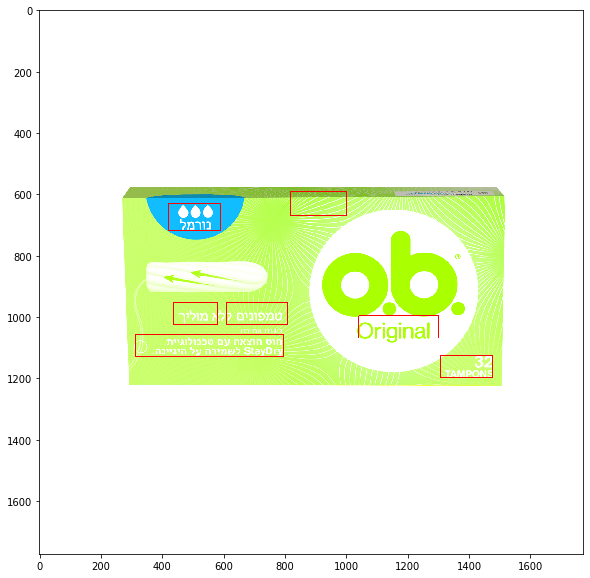

In [31]:
rcParams['figure.figsize'] = 10, 10
plt.imshow(orig)

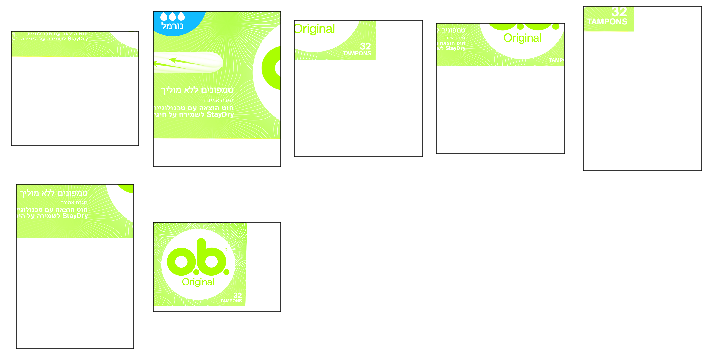

In [32]:
orig_item = rgb_item.copy()
for i in range(len(text_bounding_boxes)):    
    plt.subplot(4, 5, i+1)
    x, y, w, h = text_bounding_boxes_info[i]
    plt.imshow(orig_item[y:y+h, x:x+w], cmap='gray')
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()


In [33]:
shelf_output = rgb_shelf_2.copy()
shelf_output = cv2.resize(shelf_output, (900, 900))

for i in range (len(bounding_boxes_after_sift)): # run over patchs
    patche_keypoints, patche_descriptors = sift.detectAndCompute(bounding_boxes_after_sift[i], None) # get sift for each pach
    print('Check patch: ', i)
    text_matche_num = 0
    for j in range(len(text_bounding_boxes)): # run over text area
        obj_text_keypoints, obj_text_descriptors = sift.detectAndCompute(text_bounding_boxes[j], None) # get sift for text area
                 
        try:
            matches = flann.knnMatch(obj_text_descriptors, patche_descriptors, k=2)
        except:
            continue
        
       
        for k,(m,n) in enumerate(matches):
            if m.distance < 0.55*n.distance:                   
                text_matche_num = text_matche_num + 1
                break
                 
    
    if text_matche_num > 4:
        x, y, w, h  = bounding_boxes_after_sift_info[i]         
        cv2.rectangle(shelf_output, (x, y), (x+w, y+h), (0, 255, 0), 2) 
        #cv2.putText(shelf_output, str(text_matche_num),(x, y), cv2.FONT_HERSHEY_SIMPLEX,  1, (255, 0, 0), 2, cv2.LINE_AA) #debug
        
                


Check patch:  0
Check patch:  1
Check patch:  2
Check patch:  3
Check patch:  4
Check patch:  5
Check patch:  6
Check patch:  7
Check patch:  8
Check patch:  9
Check patch:  10
Check patch:  11
Check patch:  12
Check patch:  13
Check patch:  14
Check patch:  15
Check patch:  16


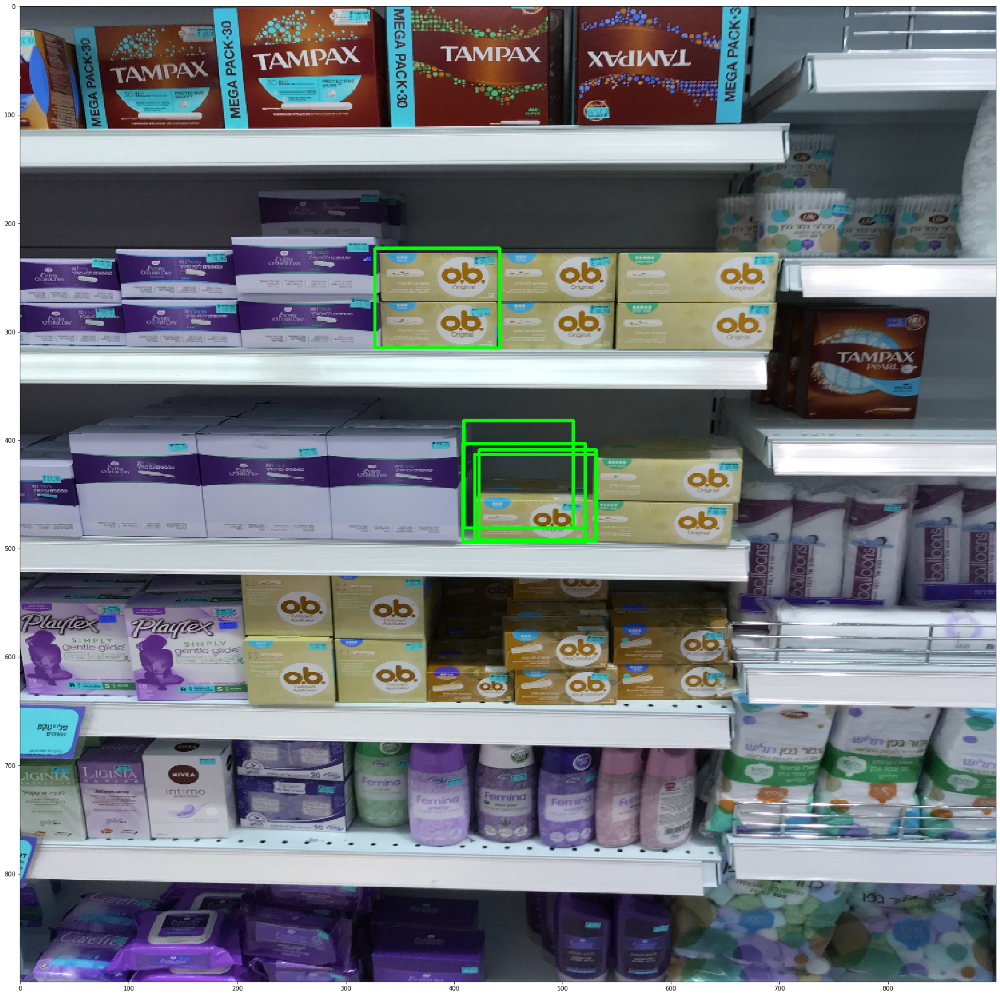

In [34]:
rcParams['figure.figsize'] = 30, 30
plt.imshow(shelf_output, cmap='gray')   
results.append(shelf_output)

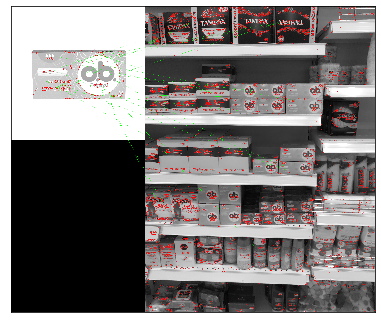

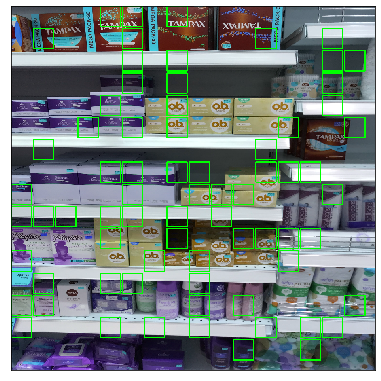

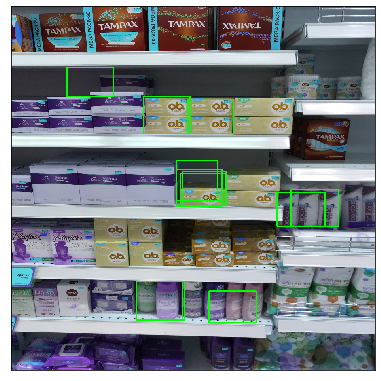

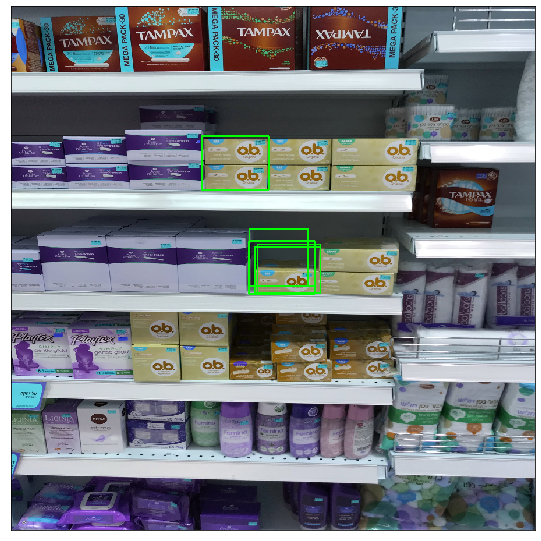

In [35]:
for i in range(len(results)):    
    plt.figure(figsize=(30, 30))
    plt.subplot(1, len(results), i+1)
    plt.imshow(results[i], cmap='gray')
    plt.xticks([])
    plt.yticks([])
plt.tight_layout()
plt.show()


